# OpenStreetMap Introduction

In [1]:
import osmnx as ox
import matplotlib.pyplot as plt

In [4]:
# Specify the name that is used to search for the data
place_name = "Shinjuku, Tokyo, Japan"

## Graph to GeoDataFrame

In [5]:
# Fetch OSM street network from the location
graph = ox.graph_from_place(place_name)

In [6]:
type(graph)

networkx.classes.multidigraph.MultiDiGraph

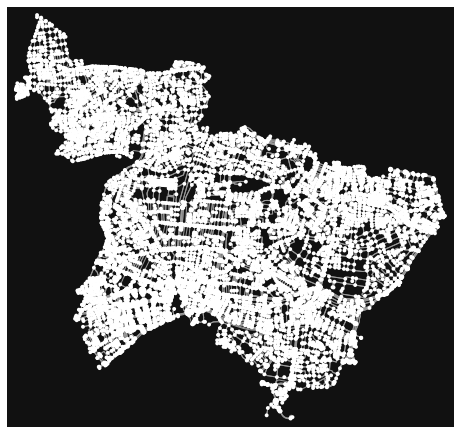

In [7]:
fig, ax = ox.plot_graph(graph)

## Place Polygon

In [8]:
# Retrive nodes and edges
nodes, edges = ox.graph_to_gdfs(graph)

In [9]:
nodes.head()

,y,x,osmid,highway,ref,geometry
158030410,35.690396,139.704528,158030410,NaN,NaN,POINT (139.70453 35.69040)
158030430,35.692908,139.706052,158030430,NaN,NaN,POINT (139.70605 35.69291)
158030491,35.697904,139.707439,158030491,traffic_signals,NaN,POINT (139.70744 35.69790)
158030532,35.703441,139.708426,158030532,NaN,NaN,POINT (139.70843 35.70344)
191499365,35.695860,139.688428,191499365,traffic_signals,NaN,POINT (139.68843 35.69586)


In [10]:
# Get place boundary related to the place name as a geodataframe
area = ox.geocode_to_gdf(place_name)

In [11]:
type(area)

geopandas.geodataframe.GeoDataFrame

In [13]:
area

,geometry,place_name,bbox_north,bbox_south,bbox_east,bbox_west
0,"POLYGON ((139.67326 35.71966, 139.67353 35.719...","Shinjuku, Tokyo, Japan",35.729915,35.673288,139.745141,139.673264


<AxesSubplot:>

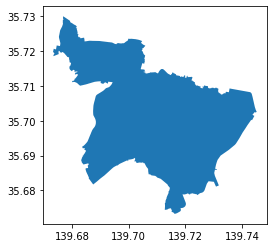

In [14]:
area.plot()

## Building footprints

In [19]:
# List key-value pairs for tags
tags = {'building': True}
ox.config(timeout = 600)

In [21]:
buildings = ox.geometries_from_place(place_name, tags)

In [22]:
len(buildings)

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


34834

In [23]:
buildings.head()

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,unique_id,osmid,element_type,name,wheelchair,geometry,ref,building,name:en,note,...,female,male,internet_access:fee,website:en,tower:type,disused:leisure,disused:sport,building:min_level,ways,type
0,node/1420771466,1420771466,node,四谷保健センター,NaN,POINT (139.71627 35.68915),NaN,public,Yotsuya Public Health Center,National-Land Numerical Information (Public Fa...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,node/1420771660,1420771660,node,国立印刷局市ヶ谷センター,NaN,POINT (139.72938 35.69501),NaN,public,National Printing Bureau Ichigaya Center,National-Land Numerical Information (Public Fa...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,node/1420771712,1420771712,node,国立科学博物館分館,NaN,POINT (139.69826 35.70563),NaN,public,National Science Museum,National-Land Numerical Information (Public Fa...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,node/1420779753,1420779753,node,平和祈念事業特別募金,NaN,POINT (139.69273 35.69113),NaN,public,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,node/1420780828,1420780828,node,新宿社会保険事務所,NaN,POINT (139.70673 35.70124),NaN,public,Shinjuku Social Insurance Office,National-Land Numerical Information (Public Fa...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
buildings.columns

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Index(['unique_id', 'osmid', 'element_type', 'name', 'wheelchair', 'geometry',
       'ref', 'building', 'name:en', 'note',
       ...
       'female', 'male', 'internet_access:fee', 'website:en', 'tower:type',
       'disused:leisure', 'disused:sport', 'building:min_level', 'ways',
       'type'],
      dtype='object', length=184)

## Points of Interest

In [25]:
tags = {'amenity': 'restaurant'}

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [28]:
# Retrive restaurants
restaurants = ox.geometries_from_place(place_name, tags)

# How many restaurants do we have?
len(restaurants)

1133

In [29]:
# Available columns
restaurants.columns.values

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


array(['unique_id', 'osmid', 'element_type', 'amenity', 'brand', 'level',
       'name', 'name:en', 'name:ja', 'name:ja_kana', 'name:ja_rm',
       'geometry', 'cuisine', 'toilets', 'toilets:access',
       'toilets:position', 'toilets:wheelchair', 'wheelchair', 'note',
       'brand:en', 'brand:ja', 'brand:wikidata', 'layer', 'opening_hours',
       'branch', 'source', 'outdoor_seating', 'phone', 'website',
       'takeaway', 'cuisine:ja', 'end_date', 'smoking', 'addr:housename',
       'addr:postcode', 'addr:street', 'alt_name', 'int_name',
       'brand:wikipedia', 'description', 'addr:full', 'contact:phone',
       'addr:city', 'addr:housenumber', 'addr:neighbourhood',
       'addr:province', 'addr:quarter', 'email', 'levels', 'operator',
       'brand:jp', 'name:jp', 'special', 'internet_access',
       'internet_access:fee', 'gay', 'lgbtq', 'name:it', 'addr:region',
       'name:fr', 'name:tr', 'name:de', 'microbrewery',
       'addr:block_number', 'name:es', 'name:ko', 'addr:cou

## Plotting the data

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


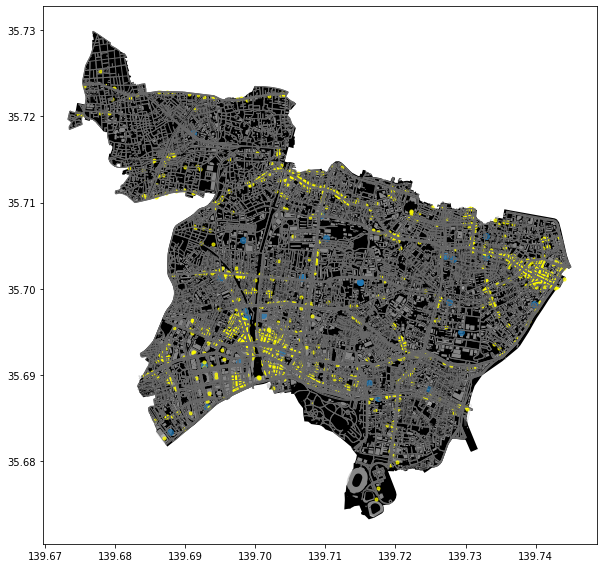

In [30]:
fig, ax = plt.subplots(figsize=(12,8))

# Plot the footprint
area.plot(ax=ax, facecolor='black')

# Plot street edges
edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

# Plot buildings 
buildings.plot(ax=ax, facecolor='silver', alpha=0.7)

# Plot restaurants
restaurants.plot(ax=ax, color='yellow', alpha=0.7, markersize=10)
plt.tight_layout()

## Park Polygons

In [31]:
# List key-value pairs for tags
tags = {'leisure': 'park', 'landuse': 'grass'}

In [32]:
# Get the data
parks = ox.geometries_from_place(place_name, tags)

# Check the result
print('Retrieved', len(parks), 'objects')

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
Retrieved 257 objects


In [33]:
parks.head()

/Users/shozendan/.local/share/virtualenvs/Tokyo_Human_Mobility-rYfgy7XY/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,unique_id,osmid,element_type,geometry,barrier,wheelchair,leisure,name,source,opening_hours,...,addr:suburb,name:ja-Hira,name:ja-Latn,name:zh,landuse,smoking,description,natural,ways,type
0,node/2384963817,2384963817,node,POINT (139.71500 35.68532),NaN,NaN,park,内藤町けやき公園,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,node/8090490512,8090490512,node,POINT (139.74223 35.70784),NaN,NaN,park,公開空き地,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,way/35630129,35630129,way,"POLYGON ((139.74060 35.69976, 139.74083 35.699...",NaN,NaN,park,若宮公園,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,way/35863704,35863704,way,"POLYGON ((139.68913 35.68810, 139.68922 35.688...",NaN,NaN,park,新宿中央公園,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,way/45657107,45657107,way,"POLYGON ((139.68847 35.70681, 139.68836 35.706...",NaN,NaN,park,新宿区 神田上水公園,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


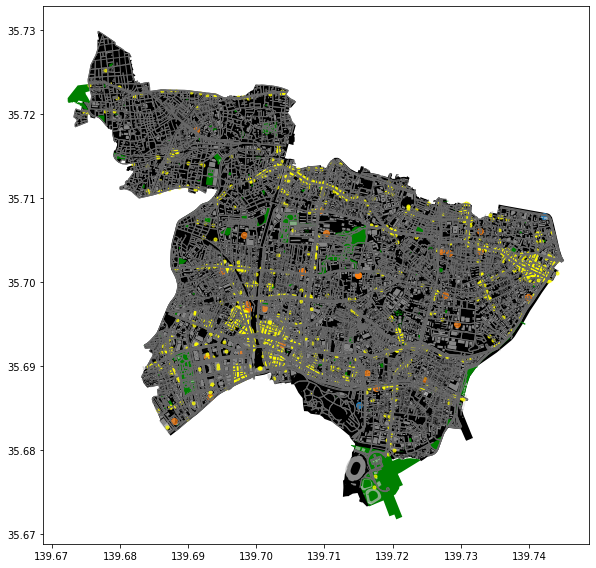

In [34]:
fig, ax = plt.subplots(figsize=(12,8))

# Plot the footprint
area.plot(ax=ax, facecolor='black')

# Plot the parks
parks.plot(ax=ax, facecolor="green")

# Plot street edges
edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

# Plot buildings
buildings.plot(ax=ax, facecolor='silver', alpha=0.7)

# Plot restaurants
restaurants.plot(ax=ax, color='yellow', alpha=0.7, markersize=10)
plt.tight_layout()